In [7]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay, classification_report
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier

# import ensemble methods
from sklearn.ensemble import (
    BaggingClassifier,
    AdaBoostClassifier,
    GradientBoostingClassifier,
    VotingClassifier,
    StackingClassifier,
)

# import base estimators
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import (
    accuracy_score,
    f1_score,
    ConfusionMatrixDisplay,
    RocCurveDisplay,
)

from xgboost import XGBClassifier
from imblearn.combine import SMOTEENN

from sklearn.tree import plot_tree
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import classification_report

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from IPython.display import display

In [8]:
df_original  = pd.read_csv("conversion_data_train.csv")
df_original

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0
...,...,...,...,...,...,...
284575,US,36,1,Ads,1,0
284576,US,31,1,Seo,2,0
284577,US,41,1,Seo,5,0
284578,US,31,1,Direct,4,0


EDA

country : Ce champ représente le pays d'origine de l'utilisateur. Par exemple, "China", "UK", "Germany", "US", etc.

age : L'âge de l'utilisateur. Ce champ indique l'âge de chaque individu ayant interagi avec le site.

new_user : Un indicateur binaire (0 ou 1) qui montre si l'utilisateur est un nouvel utilisateur (1) ou un utilisateur existant (0).

source : La source par laquelle l'utilisateur est arrivé sur le site. Les valeurs possibles sont par exemple :

Direct : L'utilisateur a accédé directement au site.
Ads : L'utilisateur est arrivé sur le site par une publicité.
Seo : L'utilisateur est arrivé par une recherche organique, c'est-à-dire via le référencement naturel sur les moteurs de recherche.
total_pages_visited : Le nombre total de pages que l'utilisateur a visitées lors de sa session sur le site.

converted : Ce champ binaire indique si l'utilisateur a été converti (1) ou non (0). Une conversion pourrait signifier une action comme l'achat d'un produit, l'inscription à un service, ou toute autre action définie comme un objectif du site.


Pays	Population (2025)
États-Unis	342 715 948
Chine	1 424 864 149
Royaume-Uni	68 072 841
Allemagne	83 228 580

In [9]:

df_original['rate_age'] = abs((df_original['age'] - df_original['age'].mean())/df_original['age'].std())
df_original['rate_tpv'] = abs((df_original['total_pages_visited'] - df_original['total_pages_visited'].mean())/df_original['total_pages_visited'].std())

# Filtrer le DataFrame pour garder uniquement les lignes où 'rate_age' et 'rate_tpv' sont <= 3
df = df_original[(df_original['rate_age'] <= 2.5) & (df_original['rate_tpv'] <= 2.5)]
nbre_sup = df_original.shape[0]-df.shape[0]
print (f"le nbre de ligne supprimée est de : {nbre_sup}")


le nbre de ligne supprimée est de : 9935


In [10]:
df.shape

(274645, 8)

In [11]:
df.describe(include='all')

,country,age,new_user,source,total_pages_visited,converted,rate_age,rate_tpv
count,274645,274645.000000,274645.000000,274645,274645.000000,274645.000000,274645.000000,274645.000000
unique,4,NaN,NaN,3,NaN,NaN,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN,NaN,NaN
freq,153917,NaN,NaN,134566,NaN,NaN,NaN,NaN
mean,NaN,30.357869,0.692691,NaN,4.587948,0.013268,0.789236,0.693635
std,NaN,7.881620,0.461380,NaN,2.798340,0.114420,0.535456,0.476730
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000,0.052717,0.037926
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000,0.310181,0.261297
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000,0.673079,0.636371
75%,NaN,36.000000,1.000000,NaN,6.000000,0.000000,1.156943,0.935593


In [12]:
print ("nbre de valeurs null par colonne :\n")
df.isna().sum()

nbre de valeurs null par colonne :



country                0
age                    0
new_user               0
source                 0
total_pages_visited    0
converted              0
rate_age               0
rate_tpv               0
dtype: int64

In [13]:
px.histogram(df, 'country', 'converted')

In [14]:
px.histogram(df, 'age', 'converted')

In [15]:
px.histogram(df, 'source', 'converted')

In [16]:
px.histogram(df, 'total_pages_visited', 'converted')

In [17]:
target = 'converted'

x = df.drop(target, axis=1)
y = df[target].astype(str)

display(x.head(), y.head())

,country,age,new_user,source,total_pages_visited,rate_age,rate_tpv
0,China,22,1,Direct,2,1.035977,0.859742
1,UK,21,1,Ads,3,1.156943,0.560519
3,US,23,1,Seo,3,0.915011,0.560519
4,US,28,1,Direct,3,0.310181,0.560519
5,US,29,0,Seo,7,0.189215,0.636371


0    0
1    0
3    0
4    0
5    0
Name: converted, dtype: object

In [18]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42, stratify=y)

preprocessing

In [19]:
# Numerical # Standardize
# Categoric # Encode

x['new_user'] = x['new_user'].astype(str)

numerical_features = x.select_dtypes(include=np.number).columns.tolist()
categorical_features = x.select_dtypes(include=object).columns.tolist()


numerical_scaler = StandardScaler()
categorical_encoder = OneHotEncoder(drop='first')

numeric_pipeline = Pipeline([('numeric_scaler', numerical_scaler)])

categoric_pipeline = Pipeline([('categoric_encoder', categorical_encoder)])

preprocessor = ColumnTransformer([
  ('numeric_pipeline', numeric_pipeline, numerical_features),
  ('categoric_pipeline', categoric_pipeline, categorical_features),
                              ])

# Encode labels
label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(y_train)
y_test = label_encoder.transform(y_test)

print (numerical_features)
print (categorical_features)

['age', 'total_pages_visited', 'rate_age', 'rate_tpv']
['country', 'new_user', 'source']


In [ ]:
preprocessor.fit(x_train)
x_train = preprocessor.transform(x_train)
x_test = preprocessor.transform(x_test)

x_train,y_train




[[ 0.46254886  3.01125691 -0.69620688 ...  1.          0.
   1.        ]
 [ 1.09758011 -0.20826109  0.43386541 ...  1.          1.
   0.        ]
 [ 0.84356761 -0.56598531 -0.01816351 ...  1.          0.
   1.        ]
 ...
 [-1.31553864  0.14946313  0.91491611 ...  1.          0.
   1.        ]
 [ 1.60560511  1.2226358   1.33792324 ...  1.          0.
   0.        ]
 [-0.17248239  2.29580847 -1.11921401 ...  0.          0.
   1.        ]]


In [21]:
preprocessor.get_feature_names_out()

array(['numeric_pipeline__age', 'numeric_pipeline__total_pages_visited',
       'numeric_pipeline__rate_age', 'numeric_pipeline__rate_tpv',
       'categoric_pipeline__country_Germany',
       'categoric_pipeline__country_UK', 'categoric_pipeline__country_US',
       'categoric_pipeline__new_user_1',
       'categoric_pipeline__source_Direct',
       'categoric_pipeline__source_Seo'], dtype=object)

In [22]:
def graph_perf(dt_model, x_train, y_train, x_test, y_test, label_encoder, title):
    # Créer une figure avec deux sous-graphiques empilés verticalement
    fig, axes = plt.subplots(2, 2, figsize=(12, 8), gridspec_kw={'width_ratios': [1, 0.5]})
    fig.suptitle(title, fontsize=16)

    # Fonction pour afficher la matrice de confusion avec pourcentages
    def plot_confusion_matrix(ax, y_true, y_pred, labels):
        cm = confusion_matrix(y_true, y_pred, labels=label_encoder.transform(labels))
        cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
        disp.plot(cmap='Blues', values_format='d', ax=ax, colorbar=False)

        # Ajouter les pourcentages
        for i in range(cm.shape[0]):
            for j in range(cm.shape[1]):
                ax.text(j, i-0.1, f'({cm_normalized[i, j]*100:.1f}%)', 
                        ha='center', va='bottom', color='black', fontsize=10)


    # Matrice de confusion pour l'ensemble d'entraînement
    y_pred_train = dt_model.predict(x_train)
    plot_confusion_matrix(axes[0, 0], y_train, y_pred_train, label_encoder.classes_)
    axes[0, 0].set_title("Matrice de Confusion (Train)", fontsize=14)
    axes[0, 0].tick_params(axis='both', which='major', labelsize=12)

    # Matrice de confusion pour l'ensemble de test
    y_pred_test = dt_model.predict(x_test)
    plot_confusion_matrix(axes[1, 0], y_test, y_pred_test, label_encoder.classes_)
    axes[1, 0].set_title("Matrice de Confusion (Test)", fontsize=14)
    axes[1, 0].tick_params(axis='both', which='major', labelsize=12)

    # Fonction pour ajouter les métriques de performance sous forme de tableau
    def add_performance_table(ax, y_true, y_pred, labels):
        report = classification_report(y_true, y_pred, target_names=labels, output_dict=True)
        report_df = pd.DataFrame(report).transpose()

        # Arrondir les métriques à deux chiffres après la virgule
        report_df = report_df.applymap(lambda x: f'{x:.4f}' if isinstance(x, float) else x)

        # Afficher le tableau
        table = ax.table(cellText=report_df.values, colLabels=report_df.columns, rowLabels=report_df.index, cellLoc='center', loc='center')
        table.auto_set_font_size(False)
        table.set_fontsize(10)
        table.scale(1.2, 1.2)
        ax.axis('off')

    # Ajouter les métriques de performance pour l'ensemble d'entraînement
    add_performance_table(axes[0, 1], y_train, y_pred_train, label_encoder.classes_)
    axes[0, 1].set_title("Performance (Train)", fontsize=14)

    # Ajouter les métriques de performance pour l'ensemble de test
    add_performance_table(axes[1, 1], y_test, y_pred_test, label_encoder.classes_)
    axes[1, 1].set_title("Performance (Test)", fontsize=14)

    # Afficher le graphique
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

# Exemple d'utilisation de la fonction
# graph_perf(dt_best, x_train, y_train, x_test, y_test, label_encoder, title="Performance du Modèle")


In [23]:
# Train model
print("Train model...")
reg_log = LogisticRegression(max_iter = 1000)
reg_log.fit(x_train, y_train)
print("...Done.")

Train model...
...Done.


C:\Users\licor\AppData\Local\Temp\ipykernel_21268\962175036.py:39: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

C:\Users\licor\AppData\Local\Temp\ipykernel_21268\962175036.py:39: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



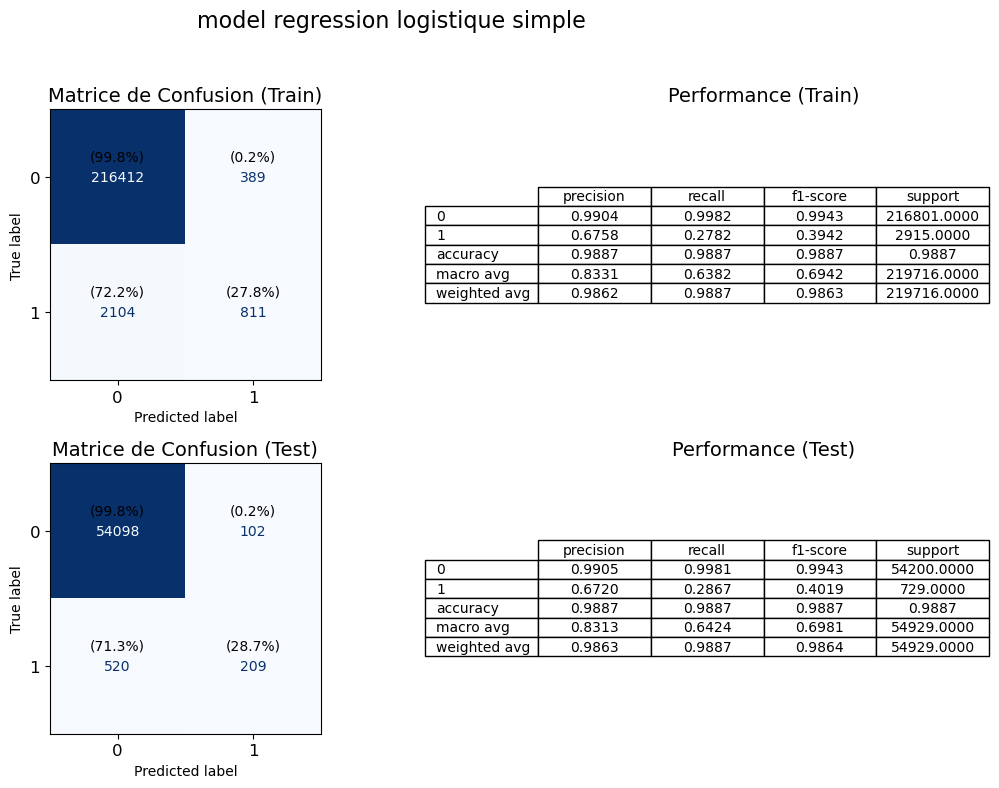

In [24]:
graph_perf(reg_log, x_train, y_train, x_test, y_test, label_encoder, title=f"model regression logistique simple " )

In [25]:
# Perform grid search
print("Grid search...")
xgboost = XGBClassifier()

# Grid of values to be tested
params = {
    "max_depth": [1,2,3,],  # exactly the same role as in scikit-learn
    "min_child_weight": [1, 2, 3 ],  # effect is more or less similar to min_samples_leaf and min_samples_split
    "n_estimators": [123, 124,125],  # exactly the same role as in scikit-learn
        }

print(params)

gridsearch = GridSearchCV(
    xgboost, param_grid=params, cv=5,n_jobs=-1
)  # cv : the number of folds to be used for CV
gridsearch.fit(x_train, y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)
print()
print("Accuracy on training set : ", gridsearch.score(x_train, y_train))
print("Accuracy on test set : ", gridsearch.score(x_test, y_test))


Grid search...
{'max_depth': [1, 2, 3], 'min_child_weight': [1, 2, 3], 'n_estimators': [123, 124, 125]}
...Done.
Best hyperparameters :  {'max_depth': 2, 'min_child_weight': 1, 'n_estimators': 124}
Best validation accuracy :  0.988708150085646

Accuracy on training set :  0.9887718691401628
Accuracy on test set :  0.9886398805731035


C:\Users\licor\AppData\Local\Temp\ipykernel_21268\962175036.py:39: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

C:\Users\licor\AppData\Local\Temp\ipykernel_21268\962175036.py:39: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



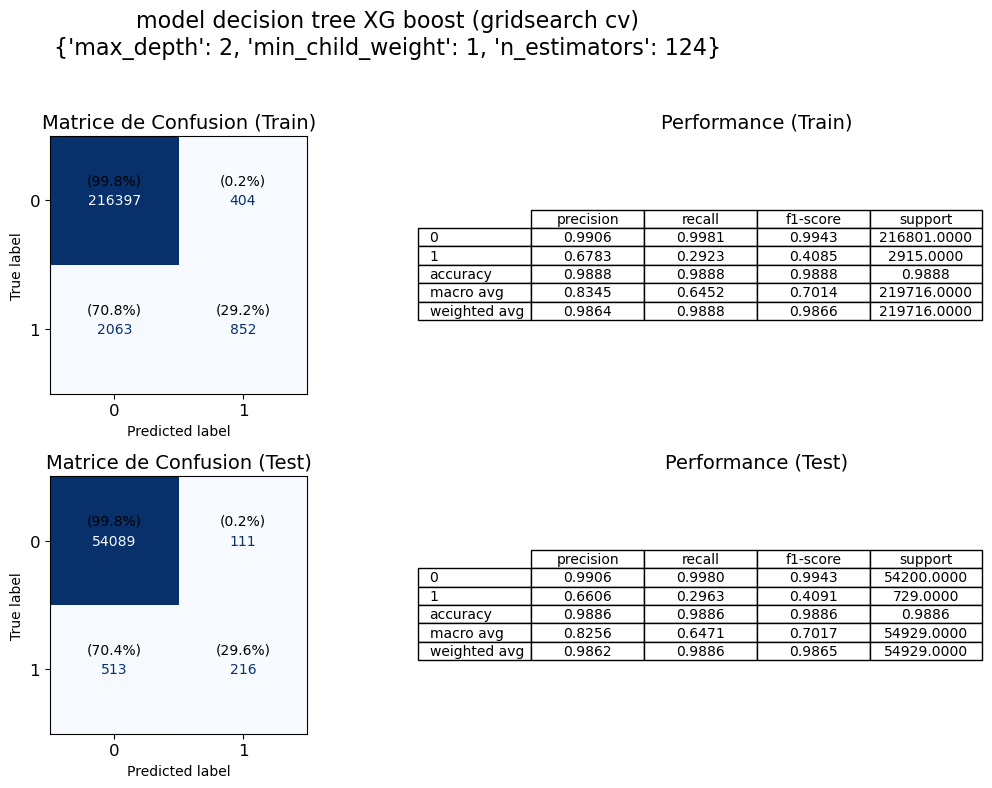

In [26]:
graph_perf(gridsearch, x_train, y_train, x_test, y_test, label_encoder, title=f"model decision tree XG boost (gridsearch cv)\n{gridsearch.best_params_}" )

In [27]:
# Instancier XGBoost comme le modèle final
xgb_model = XGBClassifier(n_jobs=-1)

# Création du StackingClassifier avec XGBoost comme modèle final
print("Training stacking classifier with XGBoost as final estimator...")
stacking = StackingClassifier(
    estimators=[("logistic", reg_log), ("tree", gridsearch)], 
    final_estimator=xgb_model, 
    cv=5
)

# Entraîner le modèle
preds = stacking.fit_transform(x_train, y_train)

# Convertir les prédictions en DataFrame pour afficher
predictions = pd.DataFrame(preds, columns=stacking.named_estimators_.keys())
print("...Done.")

# Affichage des prédictions
display(predictions)

# Évaluation des performances
print("Accuracy on training set : ", stacking.score(x_train, y_train))
print("Accuracy on test set : ", stacking.score(x_test, y_test))


Training stacking classifier with XGBoost as final estimator...
...Done.


,logistic,tree
0,0.016826,0.019165
1,0.000030,0.000089
2,0.000065,0.000043
3,0.000007,0.000011
4,0.000833,0.001074
...,...,...
219711,0.003587,0.003043
219712,0.000974,0.000849
219713,0.000095,0.000101
219714,0.000035,0.000071


Accuracy on training set :  0.9886808425421908
Accuracy on test set :  0.9887309071710754


C:\Users\licor\AppData\Local\Temp\ipykernel_21268\962175036.py:39: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

C:\Users\licor\AppData\Local\Temp\ipykernel_21268\962175036.py:39: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



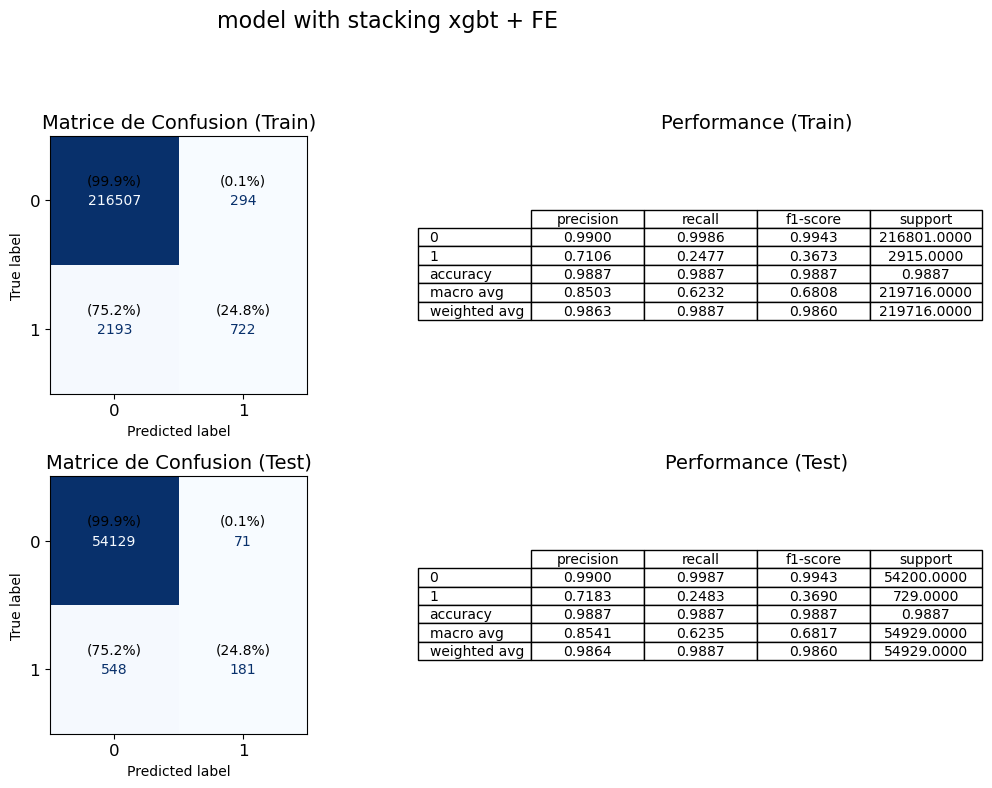

In [28]:
graph_perf(stacking, x_train, y_train, x_test, y_test, label_encoder, title=f"model with stacking xgbt + FE\n")

In [29]:
# Read data without labels
data_without_labels = pd.read_csv('conversion_data_test.csv')
print('Prediction set (without labels) :', data_without_labels.shape)
data_without_labels


FileNotFoundError: [Errno 2] No such file or directory: 'conversion_data_test.csv'

In [ ]:

data_without_labels['rate_age'] = abs((data_without_labels['age'] - df['age'].mean())/df['age'].std())
data_without_labels['rate_tpv'] = abs(((data_without_labels['total_pages_visited'] - df['total_pages_visited'].mean())/df['total_pages_visited'].std()))

data_without_labels

,country,age,new_user,source,total_pages_visited,rate_age,rate_tpv
0,UK,28,0,Seo,16,0.251832,4.456765
1,UK,22,1,Direct,5,1.068848,0.218600
2,China,32,1,Seo,1,0.292845,1.322551
3,US,32,1,Ads,6,0.292845,0.603888
4,China,25,0,Seo,3,0.660340,0.551976
...,...,...,...,...,...,...,...
31615,Germany,25,1,Seo,3,0.660340,0.551976
31616,US,36,1,Ads,7,0.837522,0.989175
31617,UK,33,1,Seo,5,0.429014,0.218600
31618,UK,25,1,Seo,14,0.660340,3.686189


In [ ]:
# WARNING : PUT HERE THE SAME PREPROCESSING AS FOR YOUR TEST SET
# CHECK YOU ARE USING X_without_labels
print("Encoding categorical features and standardizing numerical features...")

X_without_labels = preprocessor.transform(data_without_labels)
print("...Done")
print(X_without_labels[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[-0.25219759  4.45626267 -1.02153025  8.89606173  0.          1.
   0.          0.          0.          1.        ]
 [-1.06916952  0.2189653   0.65884506 -1.04084884  0.          1.
   0.          1.          1.          0.        ]
 [ 0.29245036 -1.32187011 -0.93717791  1.54750323  0.          0.
   0.          1.          0.          1.        ]
 [ 0.29245036  0.60417415 -0.93717791 -0.13749333  0.          0.
   1.          1.          0.          0.        ]
 [-0.66068356 -0.55145241 -0.18134259 -0.25920779  0.          0.
   0.          0.          0.          1.        ]]


In [ ]:
pred_test_file = stacking.predict(X_without_labels)
pred_test_file

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
# Make predictions and dump to file
# WARNING : MAKE SURE THE FILE IS A CSV WITH ONE COLUMN NAMED 'converted' AND NO INDEX !
# WARNING : FILE NAME MUST HAVE FORMAT 'conversion_data_test_predictions_[name].csv'
# where [name] is the name of your team/model separated by a '-'
# For example : [name] = AURELIE-model1
data = {
    'converted': pred_test_file}

suffixe = "jej-stxgbt_FE"

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv(f"conversion_data_test_predictions_{suffixe}.csv", index=False)